# Desafío Empresarial: Análisis de Cohortes para los Pagos de Ironhack (Proyecto 1)

#### Grupo: DKDencia
#### Miembros: Verónica Santamaría, María Pérez Cano, Mónica López Calero

# Descripción del proyecto

## Introducción


IronHack Payments, una empresa de servicios financieros de vanguardia, ha estado ofreciendo soluciones innovadoras de adelanto de efectivo desde su creación en 2020. Con un compromiso de proporcionar adelantos de dinero gratuitos y precios transparentes, IronHack Payments ha logrado una base de usuarios sustancial. Como parte de su esfuerzo continuo por mejorar sus servicios y entender el comportamiento de los usuarios, IronHack Payments ha encargado un proyecto de análisis de cohortes.


## Visión General del Proyecto


En este proyecto, realizarás un análisis de cohortes exhaustivo basado en datos proporcionados por IronHack Payments. El objetivo principal es analizar cohortes de usuarios definidos por el mes de creación de su primer adelanto en efectivo. Seguirás la evolución mensual de las métricas clave para estas cohortes, lo que permitirá a IronHack Payments obtener valiosas perspectivas sobre el comportamiento de los usuarios y el rendimiento de sus servicios financieros.


### Métricas a Analizar


Calcularás y analizarás las siguientes métricas para cada cohorte:

1. **Frecuencia de Uso del Servicio:** Comprender con qué frecuencia los usuarios de cada cohorte utilizan los servicios de adelanto de efectivo de IronHack Payments a lo largo del tiempo.
2. **Tasa de Incidentes:** Determinar la tasa de incidentes, enfocándose específicamente en los incidentes de pago, para cada cohorte. Identificar si hay variaciones en las tasas de incidentes entre diferentes cohortes.
3. **Ingresos Generados por la Cohorte:** Calcular el total de ingresos generados por cada cohorte a lo largo de los meses para evaluar el impacto financiero del comportamiento de los usuarios.
4. **Nueva Métrica Relevante:** Proponer y calcular una nueva métrica relevante que brinde perspectivas adicionales sobre el comportamiento de los usuarios o el rendimiento de los servicios de IronHack Payments.

### Herramientas de Análisis de Datos

Se espera que realices el análisis de cohortes utilizando Python, aprovechando principalmente la biblioteca Pandas para la manipulación y análisis de datos. Sin embargo, el análisis principal debe realizarse utilizando Python.


### Análisis Exploratorio de Datos (EDA)

Antes de sumergirte en el análisis de cohortes, realiza un análisis exploratorio de datos para obtener una comprensión completa del conjunto de datos. Explora estadísticas clave, distribuciones y visualizaciones para identificar patrones y valores atípicos. El EDA te ayudará a tomar decisiones informadas sobre estrategias de preprocesamiento y análisis de datos.

### Análisis de la Calidad de Datos

Evalúa la calidad del conjunto de datos identificando valores faltantes, inconsistencias en los datos y posibles errores. Implementa pasos de limpieza y preprocesamiento de datos para garantizar la fiabilidad de tu análisis. Documenta cualquier problema de calidad de datos encontrado y los pasos tomados para abordarlos.

# Entregables

1. **Código en Python:** Proporciona código en Python bien documentado que realice el análisis de cohortes, incluyendo la carga de datos, preprocesamiento, creación de cohortes, cálculo de métricas y visualización.
2. **Informe de Análisis Exploratorio de Datos:** Prepara un informe que resuma los hallazgos de tu análisis exploratorio de datos. Incluye visualizaciones e insights que ayuden a entender el conjunto de datos.
3. **Informe de Análisis de la Calidad de Datos:** Documenta los resultados de tu análisis de calidad de datos, destacando cualquier problema y los pasos tomados para resolverlos.
4. **Presentación Corta:** Crea una presentación concisa (máximo de 4 diapositivas) que resuma tus hallazgos del análisis de cohortes y las perspectivas clave obtenidas del EDA y el análisis de calidad de datos. Esta presentación debe ser adecuada para compartir con el equipo de IronHack Payments.

 **Nota:** Para mantener los standars de clean code, a partir de ahora todo el notebook será en inglés

# Library Imports

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
from ydata_profiling import ProfileReport

# Import data and DataFrame creation

In [2]:
# Casting user_id and cash_requesst_id as Int64 for later manipulation
df_cr = pd.read_csv('../project_dataset/extract - cash request - data analyst.csv', dtype={'user_id': 'Int64'})
df_fees = pd.read_csv('../project_dataset/extract - fees - data analyst - .csv', dtype={'cash_request_id': 'Int64'})

# Sanity checks and Data Quality

For better understanding of both dfs, we created independent profiles. Later on we will merge them. 

Please uncollapse this cell to see all the preliminary exploration of both datasets. You can find more insights about data quality in a separate google doc with information about zero values, duplicates, insonsistencies and others.

In [15]:
df_cr.describe()

,id,amount,user_id,deleted_account_id
count,23970.000000,23970.000000,21867.0,2104.000000
mean,13910.966124,82.720818,32581.250789,9658.755228
std,7788.117214,26.528065,27618.565773,7972.743249
min,3.000000,1.000000,34.0,91.000000
25%,7427.250000,50.000000,10804.0,3767.000000
50%,14270.500000,100.000000,23773.0,6121.500000
75%,20607.750000,100.000000,46965.0,16345.000000
max,27010.000000,200.000000,103719.0,30445.000000


In [17]:
df_fees.describe()

,id,cash_request_id,total_amount
count,21061.000000,21057.0,21061.000000
mean,10645.355111,16318.449162,5.000237
std,6099.315256,6656.149949,0.034453
min,1.000000,1456.0,5.000000
25%,5385.000000,11745.0,5.000000
50%,10652.000000,17160.0,5.000000
75%,15925.000000,21796.0,5.000000
max,21193.000000,27010.0,10.000000


In [21]:
df_cr.dtypes

id                              int64
amount                        float64
status                         object
created_at                     object
updated_at                     object
user_id                         Int64
moderated_at                   object
deleted_account_id            float64
reimbursement_date             object
cash_request_received_date     object
money_back_date                object
transfer_type                  object
send_at                        object
recovery_status                object
reco_creation                  object
reco_last_update               object
dtype: object

In [25]:
df_fees.dtypes

id                   int64
cash_request_id      Int64
type                object
status              object
category            object
total_amount       float64
reason              object
created_at          object
updated_at          object
paid_at             object
from_date           object
to_date             object
charge_moment       object
dtype: object

In [24]:
profile_df_cr = ProfileReport(df_cr, title = "Profile CR")
profile_df_cr

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [25]:
profile_df_fees = ProfileReport(df_fees, title = "Profile Fees")
profile_df_fees

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Data Analysis Exploration

In [49]:
# Merging both DataFrames

df = df_cr.merge(df_fees, left_on='id', right_on='cash_request_id', how='left', suffixes=('_cr', '_fees'))

In [7]:
# We will add in the following cells, some interesting information that we will use in the presentation

# Median of amount of cash requests
df['amount'].median()

100.0

In [9]:
# Total number of cash requests made
df['id_cr'].nunique()

23970

In [11]:
# Number of approved cash requests
len(df_cr[(df_cr['status'] == 'active') | (df_cr['status'] == 'direct_debit_sent') | (df_cr['status'] == 'money_back')])

16490

In [51]:
# Total Revenue made
revenue_made = df['total_amount'].sum()
revenue_made

105290.0

In [59]:
# To know how many months have the company been active (at least from our data) we do the following
# Convert create_at_cr into datetime
df['created_at_cr'] = pd.to_datetime(df['created_at_cr'])

# We need this to knwo how much revenue per month
months = (df['created_at_cr'].max() - df['created_at_cr'].min())

months_in_days = months.days + months.seconds / 86400  # Convert seconds to days
months_exact = months_in_days / 30.44  # approximate using 30.44 days per month
months_exact

11.445663068209472

In [61]:
# Revenue per month
revenue_month = revenue_made / months_exact
revenue_month

9199.117549811928

In [63]:
profile_df = ProfileReport(df, title = "Profile all")
profile_df

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

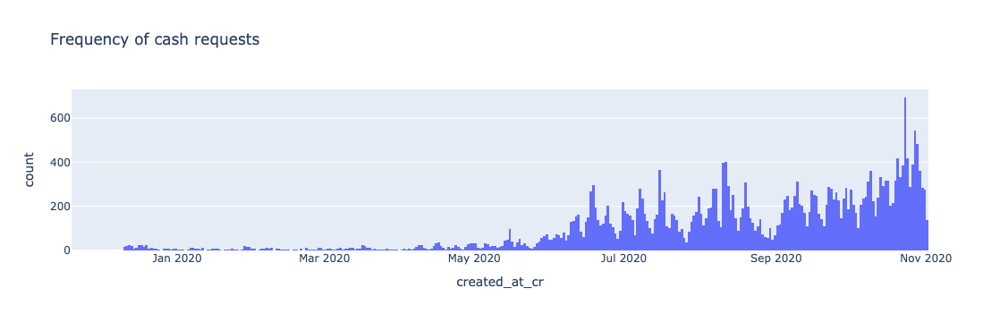

In [69]:
fig = px.histogram(df, x='created_at_cr', nbins=500, title='Frequency of cash requests')
fig.show()

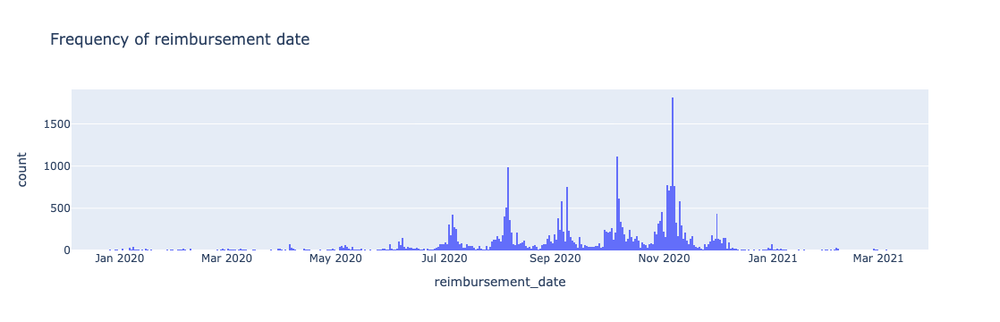

In [71]:
fig2 = px.histogram(df, x='reimbursement_date', nbins=500, title='Frequency of reimbursement date')
fig2.show()

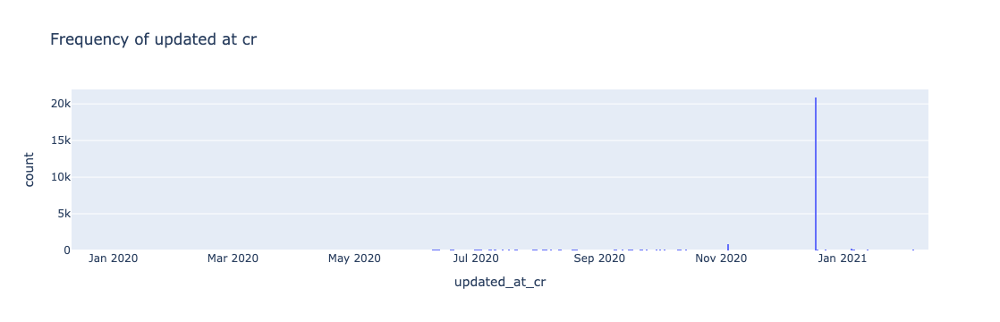

In [73]:
fig3 = px.histogram(df, x='updated_at_cr', nbins=500, title='Frequency of updated at cr')
fig3.show()

In [75]:
# To understand the usual days between the cr is created and the reimbursement is planned
# Let's calculate the difference between the two variables
# First convert the variables into datetime

df['created_at_cr'] = pd.to_datetime(df['created_at_cr'], format = 'mixed')
df['reimbursement_date'] = pd.to_datetime(df['reimbursement_date'], format = 'mixed')

# In a new column, get the difference between created at and reimbursement and convert into days 
df['time_diff_created_reimburs_days'] = (df['reimbursement_date'] - df['created_at_cr']).dt.days


# Calculate the median
df['time_diff_created_reimburs_days'].median()



24.0

In [77]:
# Looks like there is one transaction with negative time difference, so this might be an error
negative = (df['time_diff_created_reimburs_days'] < 0).sum()

negative_rows = df.loc[df['time_diff_created_reimburs_days'] < 0]
negative_rows

,id_cr,amount,status_cr,created_at_cr,updated_at_cr,user_id,moderated_at,deleted_account_id,reimbursement_date,cash_request_received_date,...,category,total_amount,reason,created_at_fees,updated_at_fees,paid_at,from_date,to_date,charge_moment,time_diff_created_reimburs_days
17197,8626,60.0,money_back,2020-07-17 10:37:54.852063+00:00,2020-12-18 13:09:54.18426+00,33881,2020-07-17 15:47:55+00,NaN,2020-04-03 22:00:00+00:00,2020-07-21,...,NaN,5.0,Postpone Cash Request 8626,2020-07-24 13:07:29.360173+00,2020-10-13 14:25:03.064997+00,2020-07-24 13:07:33.580417+00,2020-08-01 22:00:00+00,2020-08-03 22:00:00+00,before,-105


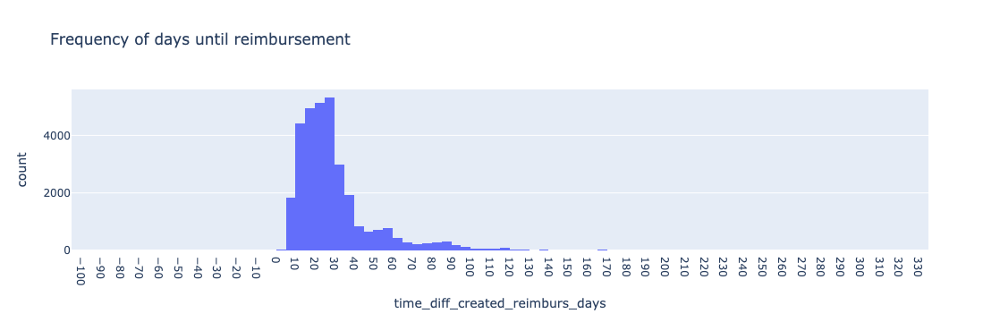

In [79]:
fig5 = px.histogram(df, x='time_diff_created_reimburs_days', nbins=100, title='Frequency of days until reimbursement')
fig5.update_xaxes(nticks=50) 
fig5.show()

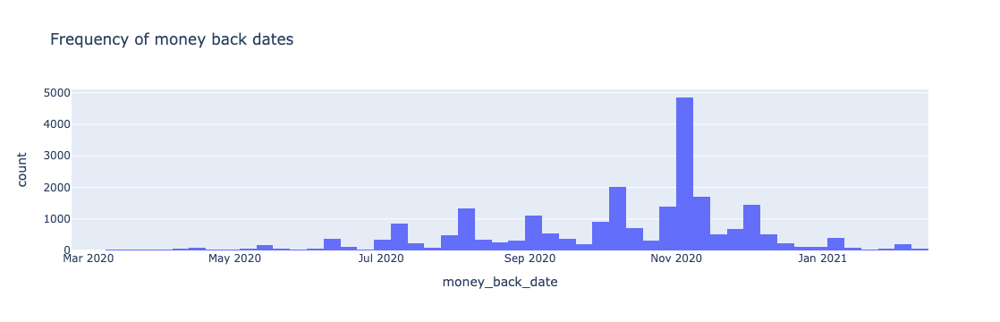

In [81]:
# money_back_date

fig6 = px.histogram(df, x='money_back_date', nbins=100, title='Frequency of money back dates')
fig6.show()

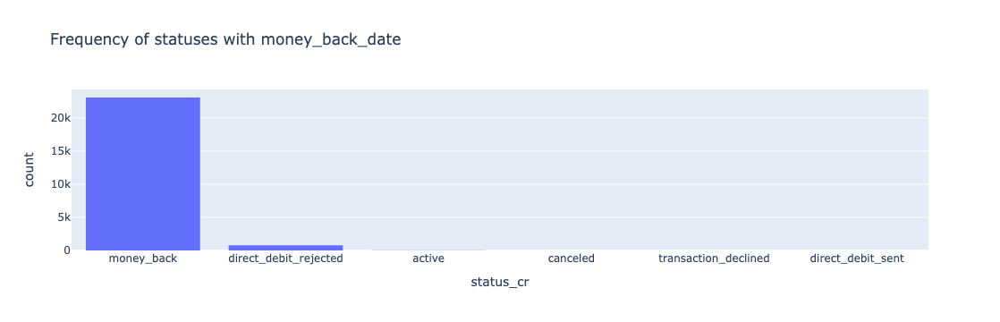

In [83]:
# with money back date not null

df_mbd_notnull = df[df['money_back_date'].notnull()]

fig7 = px.histogram(df_mbd_notnull, x='status_cr', nbins = 1000, title='Frequency of statuses with money_back_date')

fig7.show()


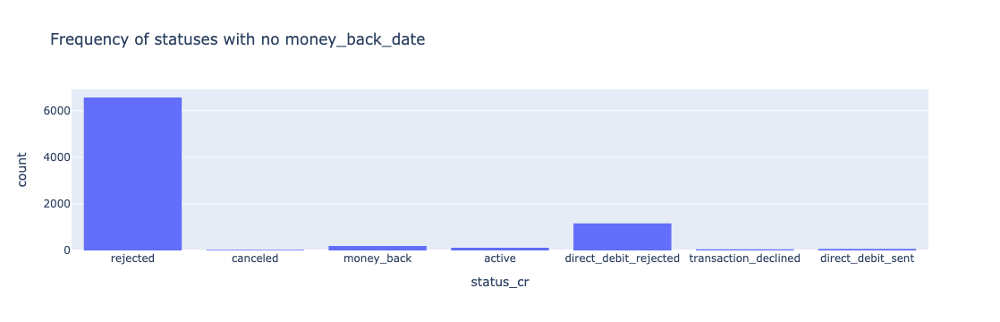

In [85]:
# without money back date

df_mbd_isnull = df[df['money_back_date'].isnull()]

fig8 = px.histogram(df_mbd_isnull, x='status_cr', nbins = 1000, title='Frequency of statuses with no money_back_date')

fig8.show()

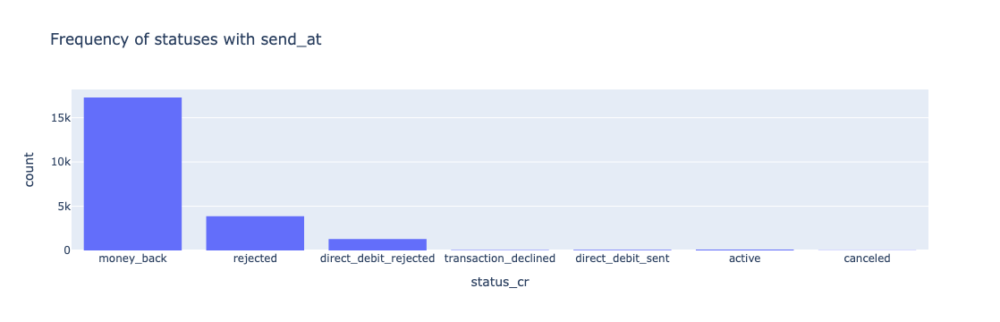

In [87]:
# send_at is not null

df_send_at_notnull = df[df['send_at'].notnull()]

fig9 = px.histogram(df_send_at_notnull, x='status_cr', nbins = 1000, title='Frequency of statuses with send_at')

fig9.show()

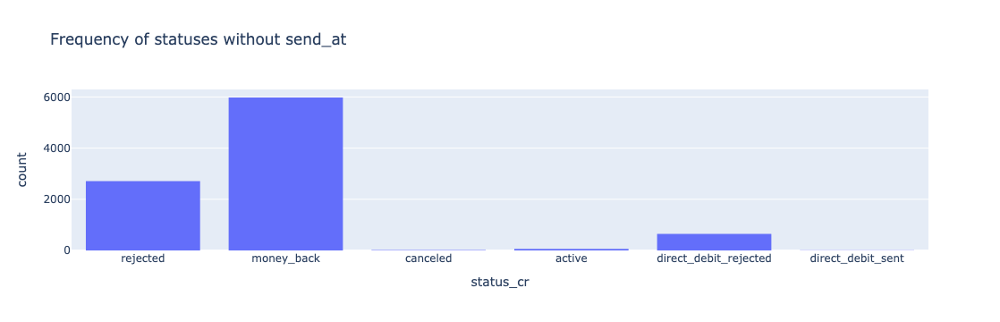

In [89]:
# send_at is null

df_send_at_isnull = df[df['send_at'].isnull()]

fig10 = px.histogram(df_send_at_isnull, x='status_cr', nbins = 1000, title='Frequency of statuses without send_at')

fig10.show()

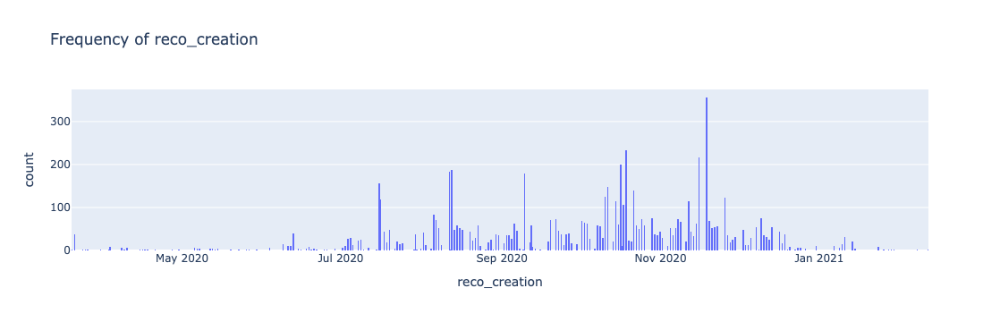

In [41]:
# reco_creation

fig11 = px.histogram(df, x='reco_creation', nbins = 1000, title='Frequency of reco_creation')

fig11.show()

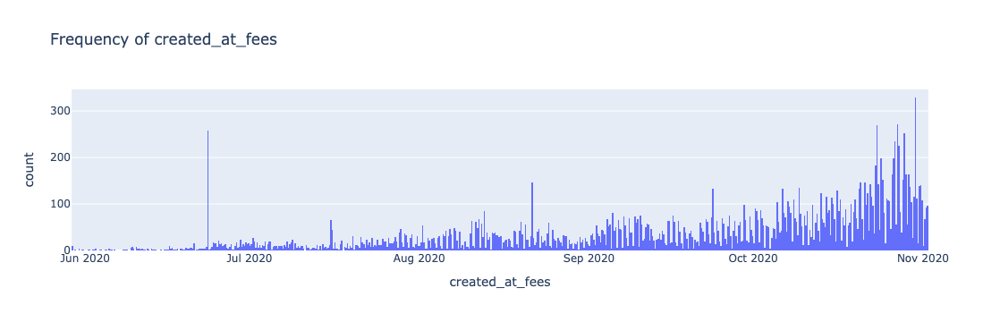

In [91]:
# created_at_fees

fig12 = px.histogram(df, x='created_at_fees', nbins = 1000, title='Frequency of created_at_fees')

fig12.show()

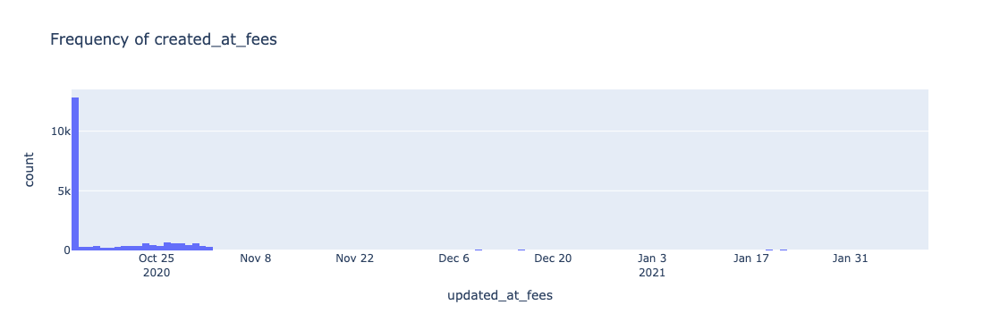

In [43]:
# updated_at_fees

fig13 = px.histogram(df, x='updated_at_fees', nbins = 150, title='Frequency of created_at_fees')

fig13.show()

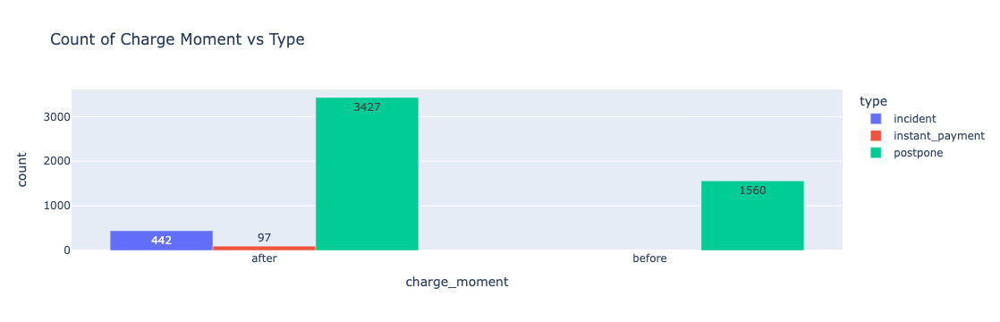

In [93]:
# charge_moment and type
df_filtered = df[df['paid_at'].isna()]

counts = df_filtered.groupby(['charge_moment', 'type']).size().reset_index(name='count')

figure = px.bar(counts, 
             x='charge_moment', 
             y='count', 
             color='type', 
             barmode='group', 
             text='count',
             title='Count of Charge Moment vs Type')

figure.show()


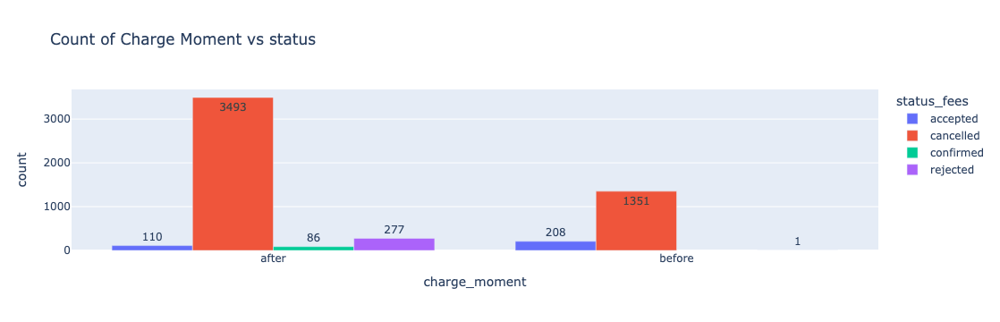

In [95]:
# charge_moment and status
df_filtered = df[df['paid_at'].isna()]

counts_status = df_filtered.groupby(['charge_moment', 'status_fees']).size().reset_index(name='count')

figure1 = px.bar(counts_status, 
             x='charge_moment', 
             y='count', 
             color='status_fees', 
             barmode='group', 
             text='count',
             title='Count of Charge Moment vs status')

figure1.show()

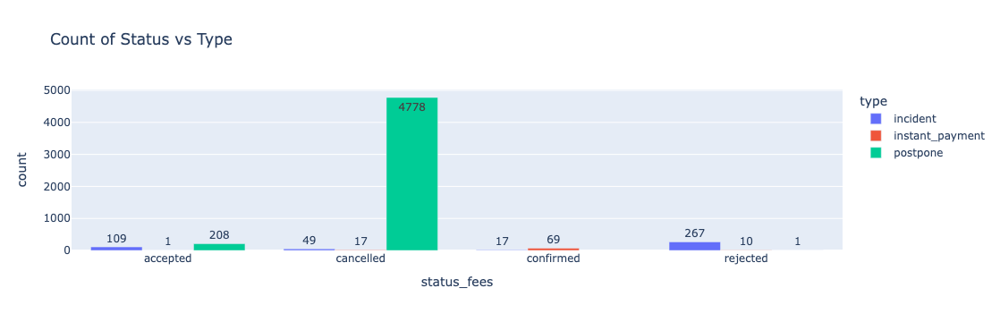

In [97]:
# status and type
df_filtered = df[df['paid_at'].isna()]

counts_type = df_filtered.groupby(['status_fees', 'type']).size().reset_index(name='count')

figure2 = px.bar(counts_type, 
             x='status_fees', 
             y='count', 
             color='type', 
             barmode='group', 
             text='count',
             title='Count of Status vs Type')

figure2.show()

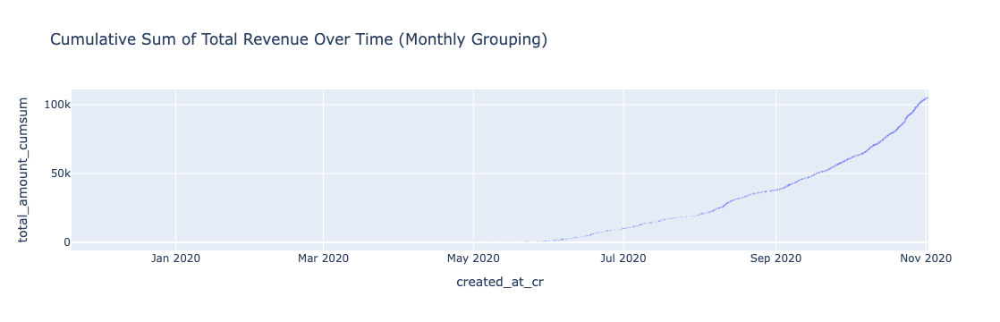

In [99]:
# Graph of the evolution of revenue (cumulative sum)
df_copy = df.copy()
df_copy['total_amount_cumsum'] = df_copy['total_amount'].cumsum()


df_copy = df_copy.sort_values('created_at_cr')

df_copy['total_amount_cumsum'] = df_copy['total_amount'].cumsum()

fig_cumsum = px.line(df_copy, 
                     x='created_at_cr', 
                     y='total_amount_cumsum',   
                     title='Cumulative Sum of Total Revenue Over Time (Monthly Grouping)'
                    )
fig_cumsum.show()


# Cohort Creation

**Important information:**
For the cohort creation, we are going to combine the deleted users (deleted_account_id) and the active users (user_id) since we want to understand the behaviour of all users independently if they removed their account at some point or not. 


In [101]:
# Combine 'user_id' and 'deleted_account_id' in 'user_id_combined'
df['user_id_combined'] = df['user_id'].combine_first(df['deleted_account_id'])

# We ensure created_at_cr is a timestamp
df['created_at_cr'] = pd.to_datetime(df['created_at_cr'])

# Group by 'user_id_combined'and aggregate for the min date of created_at_cr
df_cohort = df.groupby('user_id_combined').agg(first_cr_at=('created_at_cr', 'min')).reset_index()

# Extract the cohort month (year and month) from the first cash request date
df_cohort['cohort_month'] = df_cohort['first_cr_at'].dt.to_period('M')

# Merge new column cohort with the original 
df = df.merge(df_cohort[['user_id_combined', 'cohort_month']], on='user_id_combined', how='left')

# Calculate the 'age' of the cohort (difference in months between the cash advance and cohort month)
# Extract the advance month from the 'created_at_cr' column
df['cr_month'] = df['created_at_cr'].dt.to_period('M')

/var/folders/sf/4z0xt3ds7c10wknwytn13qj00000gq/T/ipykernel_21481/5810569.py:11: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.

/var/folders/sf/4z0xt3ds7c10wknwytn13qj00000gq/T/ipykernel_21481/5810569.py:18: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



In [103]:
# Calculate the difference in months between the cash request month and the cohort month
# Since cr_month and cohort_month are type Period, we first calculate the difference in years *12 months, 
# and add it to the difference in months
df['cohort_age'] = ((df['cr_month'].dt.year - df['cohort_month'].dt.year) * 12 +
                    (df['cr_month'].dt.month - df['cohort_month'].dt.month))

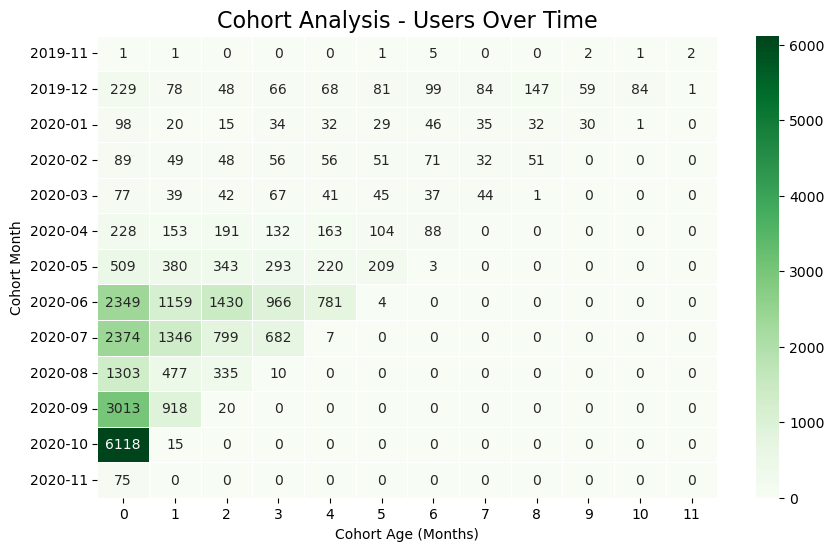

In [105]:
# Cohort visualization by user_id

cohort_pivot = df.pivot_table(index='cohort_month', columns='cohort_age', values='user_id', aggfunc='count')

# Fill NaN values with 0 to avoid issues with the heatmap
cohort_pivot = cohort_pivot.fillna(0)

# Convert all values to integers
cohort_pivot = cohort_pivot.astype(int)

plt.figure(figsize=(10, 6))

sns.heatmap(cohort_pivot, annot=True, fmt="d", cmap="Greens", linewidths=0.5)

plt.title("Cohort Analysis - Users Over Time", fontsize=16)
plt.xlabel("Cohort Age (Months)") 
plt.ylabel("Cohort Month")

plt.show()

This is the representations of the cohorts by counts of users. This provides the evolution of users that are registered in the Ironhack Payments platform that have at least made one cash request.

**Insight:**

- Recent cohorts (mid-2020 and beyond) have larger user bases, but retention challenges remain, as only a portion of users remain active after the first few months.
- October 2020 saw a particularly large influx of new users (6,118), but further data is needed to determine how many of these users continue using the service in subsequent months.
- Focus should be placed on improving early-stage retention strategies to prevent high churn rates in the first 3–6 months after a user joins.

# Metrics

## 1. Frequency of Service Usage
Understand how often users from each cohort utilize IronHack Payments' cash advance services over time.

In [108]:
# Create a pivot table 
cohort_pivot_freq_cr = df.pivot_table(index='cohort_month', columns='cohort_age', values='id_cr', aggfunc='count')

cohort_pivot_freq_cr

cohort_age,0,1,2,3,4,5,6,7,8,9,10,11
cohort_month,,,,,,,,,,,,
2019-11,1.0,1.0,NaN,NaN,NaN,1.0,5.0,NaN,NaN,2.0,1.0,2.0
2019-12,288.0,106.0,63.0,79.0,82.0,91.0,114.0,89.0,149.0,59.0,85.0,1.0
2020-01,117.0,24.0,17.0,35.0,36.0,34.0,50.0,35.0,32.0,30.0,1.0,NaN
2020-02,97.0,49.0,49.0,58.0,60.0,60.0,72.0,32.0,51.0,NaN,NaN,NaN
2020-03,99.0,42.0,47.0,72.0,47.0,54.0,41.0,44.0,1.0,NaN,NaN,NaN
2020-04,264.0,173.0,218.0,162.0,176.0,117.0,89.0,NaN,NaN,NaN,NaN,NaN
2020-05,587.0,455.0,381.0,330.0,246.0,216.0,4.0,NaN,NaN,NaN,NaN,NaN
2020-06,2709.0,1321.0,1566.0,1042.0,831.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN
2020-07,2683.0,1450.0,853.0,709.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


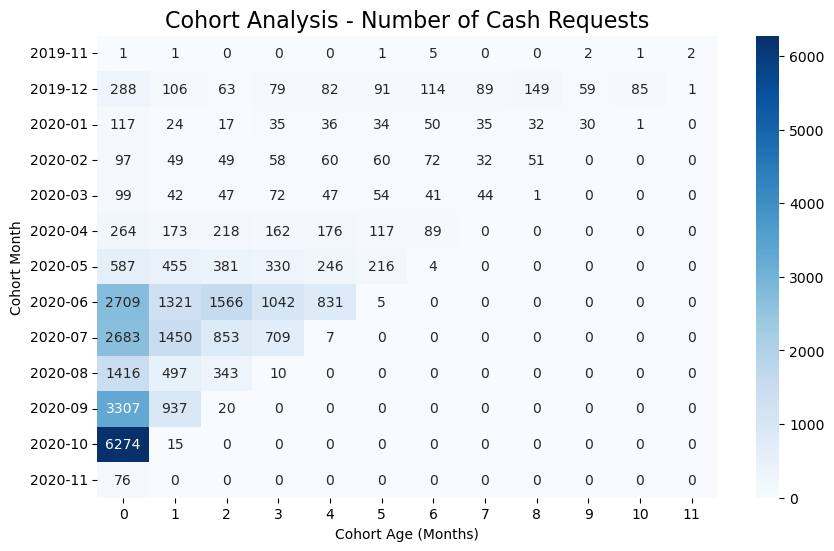

In [110]:
# Ensure plots are displayed inline in the notebook
%matplotlib inline

# Fill NaN values with 0 to avoid issues with the heatmap
cohort_pivot_freq_cr = cohort_pivot_freq_cr.fillna(0)

# Convert all values to integers
cohort_pivot_freq_cr = cohort_pivot_freq_cr.astype(int)

plt.figure(figsize=(10, 6))

sns.heatmap(cohort_pivot_freq_cr, annot=True, fmt="d", cmap="Blues")

plt.title("Cohort Analysis - Number of Cash Requests", fontsize=16)
plt.xlabel("Cohort Age (Months)")
plt.ylabel("Cohort Month")

plt.show()

**Insights:**
- High Initial Engagement but Rapid Drop-Off: Most cohorts, especially those from mid-2020 onward, show strong initial engagement (high number of cash requests in month 0), but this engagement drops off sharply after the first few months. This aligns with earlier observations about churn, where users tend to disengage after the first few months of activity.

- Sustained Engagement in June and July 2020 Cohorts: The June and July 2020 cohorts stand out for having more sustained user engagement. These cohorts continued to generate a significant number of cash requests for several months, with June 2020 maintaining more than 1,000 requests by month 3. However, even these cohorts experience a significant drop by month 5 or 6.

- Recent Cohorts Show High Initial Activity but Lack Long-Term Engagement: The October and September 2020 cohorts display the highest initial activity in terms of cash requests, with thousands of requests in month 0. However, there is no data for activity in subsequent months, either due to limited data availability or because these cohorts may not have yet reached future months of activity.

## 2. Incident Rate 

Determine the incident rate, specifically focusing on payment incidents, for each cohort. Identify if there are variations in incident rates among different cohorts.

In [117]:
# Create new column for flagging if the fee has an incident
# We assume incidents refer to all the fees with status as cancelled and rejected.

df['is_incident'] = np.where(df['status_fees'].isin(['canceled', 'rejected']), 1, 0)

In [119]:
# How many incidents?
df['is_incident'].sum()

1194

In [121]:
# Overall incident rate
incident_rate_overall = (df['is_incident'].sum() / df['id_cr'].nunique())
print("{:.2%}".format(incident_rate_overall))

4.98%


In [123]:
# Group by cohort_month and calculate the total number of incidents and cash requests
cohort_metrics = df.groupby('cohort_age').agg(
    total_cr=('id_cr', 'count'),  
    total_incidents=('is_incident', 'sum')
).reset_index()

cohort_metrics['incident_rate'] = cohort_metrics['total_incidents'] / cohort_metrics['total_cr']

print(cohort_metrics)

    cohort_age  total_cr  total_incidents  incident_rate
0            0     17918              702       0.039178
1            1      5070              192       0.037870
2            2      3557              134       0.037672
3            3      2497               88       0.035242
4            4      1485               47       0.031650
5            5       578               12       0.020761
6            6       375                7       0.018667
7            7       200                7       0.035000
8            8       233                4       0.017167
9            9        91                0       0.000000
10          10        87                1       0.011494
11          11         3                0       0.000000


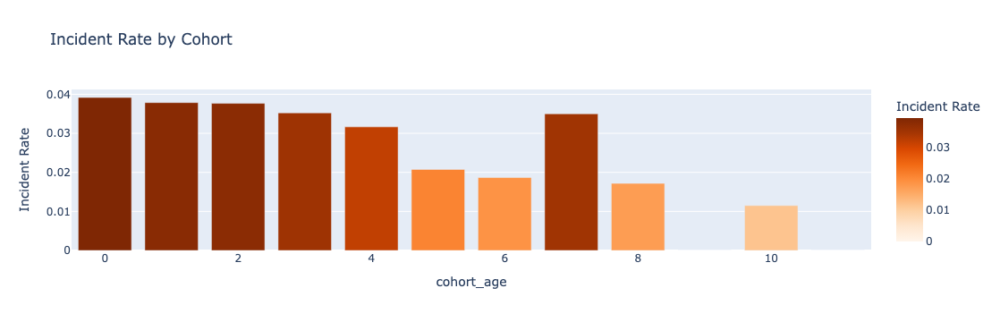

In [125]:
fig_inc = px.bar(
    cohort_metrics, 
    x='cohort_age', 
    y='incident_rate', 
    labels={'cohort_month': 'Cohort (Month)', 'incident_rate': 'Incident Rate'},
    title='Incident Rate by Cohort', 
    color='incident_rate',
    color_continuous_scale = 'Oranges'
)

fig_inc.show()

**Insight:**

People who have used the service repeatedly tend to have lower incidence rates than those who use them on an ad hoc basis. 

This may be because people who are 'on time users' have greater financial urgency or rather because they were unaware of how the platform works.

It is also important to note that as the cohort_age increases, the number of cash requests and users decreases and therefore the accuracy of the ratio.



## 3. Revenue Generated by the Cohort
Calculate the total revenue generated by each cohort over months to assess the financial impact of user behavior.

The revenue is going to be calculated by the sum of the total amounts of fees.

In [143]:
# Group by cohort_month, cr_month and cohort_age to calculate total revenue with total amount of fees
revenue_generated = df.groupby(['cohort_month', 'cr_month', 'cohort_age'])['total_amount'].sum().reset_index()
revenue_generated

,cohort_month,cr_month,cohort_age,total_amount
0,2019-11,2019-11,0,0.0
1,2019-11,2019-12,1,0.0
2,2019-11,2020-04,5,0.0
3,2019-11,2020-05,6,25.0
4,2019-11,2020-08,9,10.0
...,...,...,...,...
78,2020-09,2020-10,1,4235.0
79,2020-09,2020-11,2,75.0
80,2020-10,2020-10,0,29445.0
81,2020-10,2020-11,1,55.0


In [145]:
# Create a pivot table for revenue with Cohort Age
revenue_pivot = revenue_generated.pivot_table(
    index='cohort_month',        
    columns='cohort_age',    
    values='total_amount',       
    fill_value=0  # Filling with 0 where there is no revenue
)
revenue_pivot

cohort_age,0,1,2,3,4,5,6,7,8,9,10,11
cohort_month,,,,,,,,,,,,
2019-11,0.0,0.0,0.0,0.0,0.0,0.0,25.0,0.0,0.0,10.0,5.0,10.0
2019-12,0.0,0.0,0.0,0.0,0.0,60.0,250.0,180.0,560.0,180.0,325.0,0.0
2020-01,0.0,0.0,0.0,0.0,40.0,45.0,160.0,145.0,125.0,140.0,0.0,0.0
2020-02,0.0,0.0,0.0,80.0,130.0,135.0,285.0,115.0,220.0,0.0,0.0,0.0
2020-03,0.0,0.0,10.0,225.0,90.0,185.0,155.0,200.0,5.0,0.0,0.0,0.0
2020-04,5.0,180.0,585.0,405.0,640.0,405.0,345.0,0.0,0.0,0.0,0.0,0.0
2020-05,890.0,1120.0,935.0,1135.0,930.0,905.0,15.0,0.0,0.0,0.0,0.0,0.0
2020-06,6370.0,2615.0,5825.0,4160.0,3510.0,15.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-07,5875.0,4925.0,3300.0,3055.0,20.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


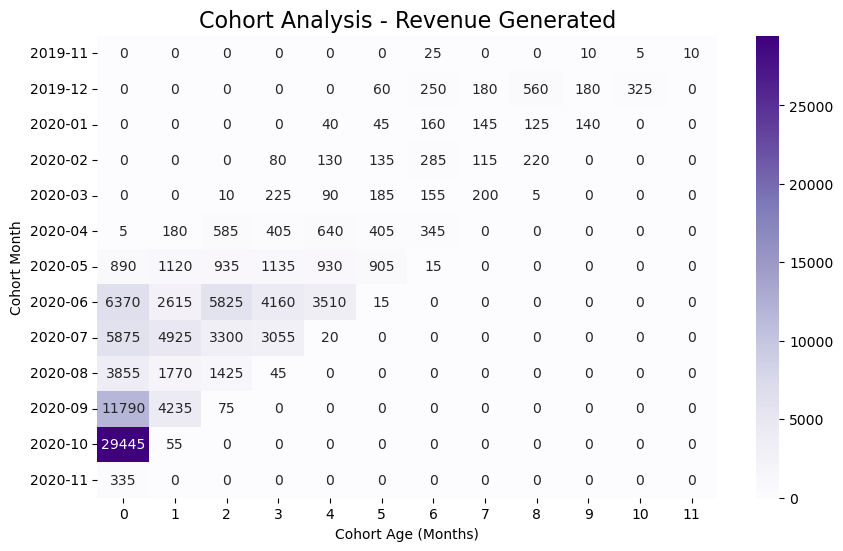

In [134]:
plt.figure(figsize=(10, 6))

sns.heatmap(revenue_pivot, annot=True, fmt=".0f", cmap="Purples")

plt.title("Cohort Analysis - Revenue Generated", fontsize=16)
plt.ylabel("Cohort Month")
plt.xlabel("Cohort Age (Months)")

plt.show()

**Insight:**
- **High initial revenue in October 2020**: The October 2020 cohort is by far the most successful in terms of initial revenue, generating almost 30,000 in its first month. However, this cohort shows no revenue in subsequent months, indicating potential early churn or lack of further engagement.
- **Mid-2020 cohorts show sustained engagement**: The June 2020 and July 2020 cohorts show consistent revenue generation across several months, with relatively high amounts generated up to four or five months after the initial transaction. This sustained revenue generation indicates stronger retention and continued usage of the platform during this period.
- **Steady revenue in early 2020 cohorts**: While the revenue generated by early 2020 cohorts is lower compared to mid-2020 cohorts, there is still a notable amount of revenue being generated across multiple months. These cohorts show steady but modest engagement with the platform.

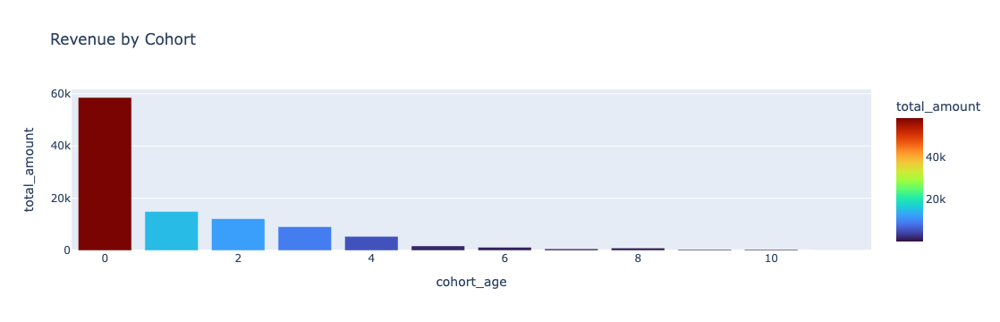

In [139]:
# Group by cohort_age and sum total_amount to plot it
revenue_grouped = revenue_generated.groupby('cohort_age', as_index=False).agg({'total_amount': 'sum'})

fig_rev = px.bar(
    revenue_grouped, 
    x='cohort_age', 
    y='total_amount', 
    title='Revenue by Cohort', 
    color='total_amount',
    color_continuous_scale = 'Turbo'
)

fig_rev.show()

**Insight:**

As seen above, we see that the revenue is highly concentrated in the early cohort

## 4. New Relevant Metric 
Propose and calculate a new relevant metric that provides additional insights into user behavior or the performance of IronHack Payments' services.

The proposed metric is **Churn Rate**.It represents the percentage of users who deleted their account after having been active for a certain period of time. It is a crucial metric for assessing user retention and satisfaction with the service.

$\text{Churn Rate} = \frac{\text{Number of deleted accounts}}{\text{Total number of users}}\times 100$


In [510]:
# Create a column that indicates if the user has churned (1 if 'deleted_account_id' is not null, 0 otherwise)

df['is_churned'] = np.where(df['deleted_account_id'].notna(), 1, 0)

# Group by cohort and cohort age to count active users and churned users
cohort_churn = df.groupby(['cohort_month', 'cohort_age']).agg(
    total_users=('user_id_combined', 'nunique'),
    churned_users=('is_churned', 'sum')
).reset_index()

cohort_churn['churn_pct'] = (cohort_churn['churned_users'] / cohort_churn['total_users']) * 100

cohort_churn

,cohort_month,cohort_age,total_users,churned_users,churn_pct
0,2019-11,0,1,0,0.000000
1,2019-11,1,1,0,0.000000
2,2019-11,5,1,0,0.000000
3,2019-11,6,1,0,0.000000
4,2019-11,9,1,0,0.000000
...,...,...,...,...,...
78,2020-09,1,680,19,2.794118
79,2020-09,2,20,0,0.000000
80,2020-10,0,4802,156,3.248646
81,2020-10,1,15,0,0.000000


In [228]:
# How many users churned?
cohort_churn['churned_users'].sum()

2573

In [317]:
# What is the overall churn rate?
churn_rate = (df['is_churned'].sum() / df['user_id_combined'].nunique()) 
print("{:.2%}".format(churn_rate))

21.82%


**Warning!** 

The following graphs are created out of very few users (see cell above 👆 ), so please take that into consideration before making any major decision based on the plots

In [278]:
# Group the data by cohort_age to calculate the average churn rate for each cohort age
churn_by_age = cohort_churn.groupby('cohort_age').agg(
    avg_churn_rate=('churn_pct', 'mean')
).reset_index()

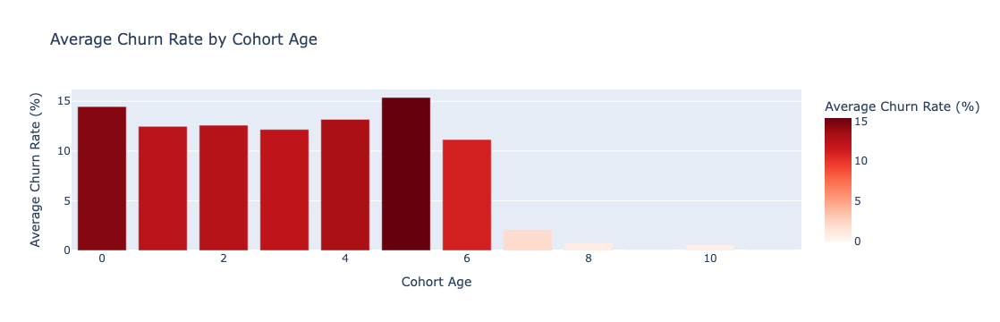

In [512]:
fig_churn_bar = px.bar(
    churn_by_age, 
    x='cohort_age',
    y='avg_churn_rate',  
    title='Average Churn Rate by Cohort Age', 
    labels={'cohort_age': 'Cohort Age', 'avg_churn_rate': 'Average Churn Rate (%)'},  
    color='avg_churn_rate',  
    color_continuous_scale='Reds'
)

fig_churn_bar.show()

**Insight fig_churn_bar:**

Cohort Age 0 and Cohort Age 5 (6th month) present the highest churn rates, near 15%. Users are more prone to delete their accounts the first month of their first cash request or around their 6th month. After that we see a huge decrease in the churn rate (also take into account there are very few users in these cohorts)

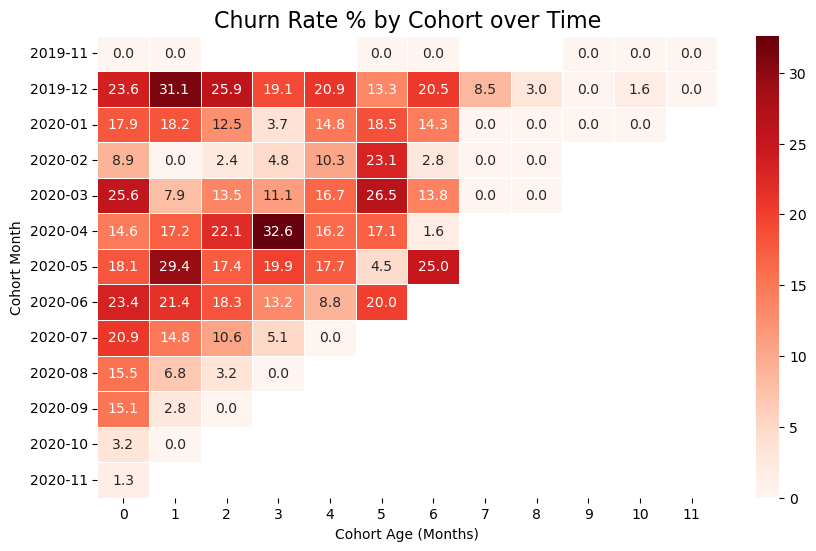

In [514]:
# Create a pivot table for visualizing the churn rate over cohort age for each cohort
cohort_pivot = cohort_churn.pivot_table(index='cohort_month', columns='cohort_age', values='churn_pct')

plt.figure(figsize=(10, 6))

# Create a heatmap to visualize the churn rate over time for each cohort
sns.heatmap(cohort_pivot, cmap="Reds", annot=True, fmt=".1f", linewidths=.5)

plt.title('Churn Rate % by Cohort over Time', fontsize=16)
plt.xlabel('Cohort Age (Months)')
plt.ylabel('Cohort Month')

plt.show()

**Insight for Churn Rate**

- The global churn rate of **21.82%** shows that more than one-fifth of users who signed up for IronHack Payments have churned.

- Out of 11,793 total users, **2,573** users have left the service, highlighting the importance of focusing on retention in the early months to reduce churn.

- More recent cohorts (such as those starting in September and October 2020) show signs of improving retention, with lower churn rates in the early months. This could be a positive sign of improved retention strategies.